In [1]:
import pickle
import numpy as np
import pandas as pd
from PIL import Image
import albumentations as A
from IPython.display import SVG
import matplotlib.pyplot as plt
import os, re, sys, random, shutil, cv2

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torch.cuda.amp import autocast
from torchvision import transforms

import timm

In [2]:
input_images_folder = '/kaggle/input/images/images'
input_masks_folder = '/kaggle/input/masks/masks'

output_images_folder = '/kaggle/working/aug_images'
output_masks_folder = '/kaggle/working/aug_masks'

In [3]:
transform = A.Compose([
    A.RandomCrop(width=384, height=512, p=1.0),
    A.HorizontalFlip(p=1.0),
    A.VerticalFlip(p=1.0),
    A.Rotate(limit=[60, 300], p=1.0, interpolation=cv2.INTER_NEAREST),
    A.RandomBrightnessContrast(brightness_limit=[-0.2, 0.3], contrast_limit=0.2, p=1.0),
    A.OneOf([
        A.GridDistortion(p=0.5),
        A.OpticalDistortion(distort_limit=1, shift_limit=0.5, interpolation=cv2.INTER_NEAREST, p=0.5),
    ], p=1.0),
], p=1.0)

os.makedirs(output_images_folder, exist_ok=True)
os.makedirs(output_masks_folder, exist_ok=True)

In [4]:
image_files = os.listdir(input_images_folder)
image_files = [f for f in image_files if f.endswith('.jpg') or f.endswith('.png')]

In [5]:
for image_file in image_files:
    src_image_path = os.path.join(input_images_folder, image_file)
    dst_image_path = os.path.join(output_images_folder, image_file)
    shutil.copyfile(src_image_path, dst_image_path)

    mask_file = image_file.replace('.jpg', '.png')
    src_mask_path = os.path.join(input_masks_folder, mask_file)
    dst_mask_path = os.path.join(output_masks_folder, mask_file)
    shutil.copyfile(src_mask_path, dst_mask_path)

In [6]:
from tqdm import tqdm
for image_file in tqdm(image_files, desc='Augmenting images'):
    image_path = os.path.join(output_images_folder, image_file)
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    mask_file = image_file.replace('.jpg', '.png')
    mask_path = os.path.join(output_masks_folder, mask_file)
    mask = cv2.imread(mask_path, cv2.COLOR_BGR2RGB)

    augmented = transform(image=image, mask=mask)
    augmented_image = augmented['image']
    augmented_mask = augmented['mask']

    output_image_path = os.path.join(output_images_folder, f"aug_{image_file}")
    output_mask_path = os.path.join(output_masks_folder, f"aug_{mask_file}")
    cv2.imwrite(output_image_path, cv2.cvtColor(augmented_image, cv2.COLOR_RGB2BGR))
    cv2.imwrite(output_mask_path, augmented_mask)

print(f"Augmentation finished. Augmented images and masks are saved in {output_images_folder} and {output_masks_folder}")



Augmenting images: 100%|██████████| 585/585 [00:20<00:00, 27.94it/s]

Augmentation finished. Augmented images and masks are saved in /kaggle/working/aug_images and /kaggle/working/aug_masks


In [7]:
images_dir = output_images_folder
masks_dir = output_masks_folder

In [8]:
from sklearn.model_selection import train_test_split

images = [os.path.join(images_dir, f) for f in os.listdir(images_dir) if os.path.isfile(os.path.join(images_dir, f))]
masks = [os.path.join(masks_dir, f) for f in os.listdir(masks_dir) if os.path.isfile(os.path.join(masks_dir, f))]

images.sort()
masks.sort()


In [9]:
data = list(zip(images, masks))

train_data, val_data = train_test_split(data, test_size=0.2, random_state=42)

train_images, train_masks = zip(*train_data)
val_images, val_masks = zip(*val_data)

In [10]:
class_dict_df = pd.read_csv('/kaggle/input/class_dict.csv', index_col=False, skipinitialspace=True, sep=';')
display(class_dict_df)

label_codes = tuple(map(tuple, class_dict_df[['r', 'g', 'b']].values))
code2id = {v:k for k,v in enumerate(label_codes)}
id2code = {k:v for k,v in enumerate(label_codes)}

name2id = {v:k for k,v in enumerate(class_dict_df['name'].values)}
id2name = {k:v for k,v in enumerate(class_dict_df['name'].values)}


,name,r,g,b
0,building,255,255,0
1,road,255,0,0
2,vegetation,0,255,0
3,water,0,0,255
4,unlabeled,0,0,0


In [11]:
def rgb_to_onehot(rgb_image, colormap = id2code):
    num_classes = len(colormap)
    shape = rgb_image.shape[:2] + (num_classes,)
    encoded_image = np.zeros(shape, dtype=np.int8)
    for i, cls in enumerate(colormap):
        encoded_image[:,:,i] = np.all(
            rgb_image.reshape((-1,3)) == colormap[i],
            axis=1
        ).reshape(shape[:2])
    return encoded_image

def onehot_to_rgb(onehot, colormap = id2code):
    single_layer = np.argmax(onehot, axis=-1)
    output = np.zeros(onehot.shape[:2] + (3,))
    for k in colormap.keys():
        output[single_layer==k] = colormap[k]
    return np.uint8(output)

def histogram_normalization(image):
    image_clahe = np.zeros_like(image, dtype=np.uint8)
    for channel in range(3):
        channel_img = image[:,:,channel].astype(np.uint8)
        clahe = cv2.createCLAHE(clipLimit=5)
        channel_clahe = clahe.apply(channel_img)
        channel_clahe = np.clip(channel_clahe + 30, 0, 255).astype(np.uint8)
        image_clahe[:,:,channel] = channel_clahe
    return image_clahe.astype(np.float32)


In [12]:
def rgb_to_class_index(rgb_image, code2id):
    h, w, _ = rgb_image.shape
    mask_out = np.zeros((h, w), dtype=np.int64)
    for rgb_tuple, cls_id in code2id.items():
        match = np.all(rgb_image == rgb_tuple, axis=-1)
        mask_out[match] = cls_id
    return mask_out

In [13]:
class SatelliteSegDataset(Dataset):
    def __init__(self, images_list, masks_list, code2id, transform_size=(512, 512)):
        self.images_list = images_list
        self.masks_list = masks_list
        self.code2id = code2id
        self.transform_size = transform_size
        
        self.to_tensor_image = transforms.Compose([
            transforms.ToPILImage(),
            transforms.Resize(self.transform_size, interpolation=transforms.InterpolationMode.BICUBIC),
            transforms.ToTensor(),
        ])
        
    def __len__(self):
        return len(self.images_list)
    
    def __getitem__(self, idx):
        img_path = self.images_list[idx]
        mask_path = self.masks_list[idx]
        
        image_bgr = cv2.imread(img_path)
        image = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
        
        mask_bgr = cv2.imread(mask_path)
        mask_rgb = cv2.cvtColor(mask_bgr, cv2.COLOR_BGR2RGB)
        
        image = histogram_normalization(image)
        
        image /= 255.0
        
        mask_index = rgb_to_class_index(mask_rgb, self.code2id)
        
        image_t = self.to_tensor_image((image * 255).astype(np.uint8))
        
        mask_pil = Image.fromarray(mask_index.astype(np.uint8))
        mask_pil = mask_pil.resize(self.transform_size, resample=Image.NEAREST)
        mask_index_resized = np.array(mask_pil, dtype=np.int64)
        mask_t = torch.from_numpy(mask_index_resized)
        
        return image_t, mask_t


In [14]:
train_dataset = SatelliteSegDataset(train_images, train_masks, code2id=code2id, transform_size=(384, 384))
val_dataset = SatelliteSegDataset(val_images, val_masks, code2id=code2id, transform_size=(384, 384))

In [15]:
batch_size = 8
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
val_loader   = DataLoader(val_dataset,   batch_size=batch_size, shuffle=False, num_workers=2)

print(f"Train dataset size = {len(train_dataset)}")
print(f"Val dataset size   = {len(val_dataset)}")

Train dataset size = 936
Val dataset size   = 234


In [16]:
num_classes = len(class_dict_df)
print("Число классов =", num_classes)

Число классов = 5


In [17]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

Using device: cuda


In [18]:
import timm
import torch.nn as nn
import torch.nn.functional as F

class LargeVitModel(nn.Module):
    def __init__(self, num_classes):
        super(LargeVitModel, self).__init__()
        self.backbone = timm.create_model(
            'timm/vit_large_patch16_384.augreg_in21k_ft_in1k', pretrained=True, features_only=True
        )
        self.segmentation_head = nn.Conv2d(
            in_channels=self.backbone.feature_info[-1]['num_chs'],
            out_channels=num_classes,
            kernel_size=1
        )

    def forward(self, x):
        features = self.backbone(x)[-1]
        
        if features.shape[1] != self.backbone.feature_info[-1]['num_chs']:
            features = features.permute(0, 3, 1, 2)
        
        logits = self.segmentation_head(features)
        
        logits = F.interpolate(logits, size=(384, 384), mode="bilinear", align_corners=False)
        return logits



num_classes = len(class_dict_df)
model = LargeVitModel(num_classes)
model.to(device)


model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

LargeVitModel(
  (backbone): FeatureGetterNet(
    (model): VisionTransformer(
      (patch_embed): PatchEmbed(
        (proj): Conv2d(3, 1024, kernel_size=(16, 16), stride=(16, 16))
        (norm): Identity()
      )
      (pos_drop): Dropout(p=0.0, inplace=False)
      (patch_drop): Identity()
      (norm_pre): Identity()
      (blocks): Sequential(
        (0): Block(
          (norm1): LayerNorm((1024,), eps=1e-06, elementwise_affine=True)
          (attn): Attention(
            (qkv): Linear(in_features=1024, out_features=3072, bias=True)
            (q_norm): Identity()
            (k_norm): Identity()
            (attn_drop): Dropout(p=0.0, inplace=False)
            (proj): Linear(in_features=1024, out_features=1024, bias=True)
            (proj_drop): Dropout(p=0.0, inplace=False)
          )
          (ls1): Identity()
          (drop_path1): Identity()
          (norm2): LayerNorm((1024,), eps=1e-06, elementwise_affine=True)
          (mlp): Mlp(
            (fc1): Linear(i

In [19]:
class TverskyLoss(nn.Module):
    def __init__(self, alpha=0.5, beta=0.5, smooth=1e-6):
        super(TverskyLoss, self).__init__()
        self.alpha = alpha
        self.beta = beta
        self.smooth = smooth

    def forward(self, logits, targets):
        num_classes = logits.shape[1]
        
        targets_one_hot = torch.nn.functional.one_hot(targets, num_classes=num_classes)
        targets_one_hot = targets_one_hot.permute(0, 3, 1, 2).float()

        probs = torch.nn.functional.softmax(logits, dim=1)

        true_pos = torch.sum(probs * targets_one_hot, dim=(2, 3))
        false_pos = torch.sum(probs * (1 - targets_one_hot), dim=(2, 3))
        false_neg = torch.sum((1 - probs) * targets_one_hot, dim=(2, 3))

        tversky_index = (true_pos + self.smooth) / (true_pos + self.alpha * false_pos + self.beta * false_neg + self.smooth)
        
        loss = 1 - tversky_index.mean()
        return loss


In [20]:
criterion = TverskyLoss(alpha=0.3, beta=0.7)
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-5)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', patience=2, factor=0.1)

In [21]:
if torch.cuda.device_count() > 1:
    print(f"Using {torch.cuda.device_count()} GPUs")
    model = nn.DataParallel(model)

In [22]:
def calculate_iou(pred, target, num_classes):
    iou_list = []
    pred = torch.argmax(pred, dim=1)
    for cls in range(num_classes):
        pred_inds = (pred == cls)
        target_inds = (target == cls)
        intersection = (pred_inds & target_inds).sum().item()
        union = (pred_inds | target_inds).sum().item()
        if union == 0:
            iou_list.append(float('nan'))
        else:
            iou_list.append(intersection / union)
    mean_iou = sum([iou for iou in iou_list if not torch.isnan(torch.tensor(iou))]) / len(iou_list)
    return mean_iou

def calculate_dice(pred, target, num_classes):
    pred = torch.argmax(pred, dim=1)
    dice_list = []
    for cls in range(num_classes):
        pred_inds = (pred == cls)
        target_inds = (target == cls)
        intersection = (pred_inds & target_inds).sum().item()
        dice = (2 * intersection) / ((pred_inds.sum().item() + target_inds.sum().item()) + 1e-6)
        dice_list.append(dice)
    mean_dice = sum(dice_list) / len(dice_list)
    return mean_dice

import torch

def calculate_precision_recall_f1_per_class(pred, target, num_classes):
    pred = torch.argmax(pred, dim=1)
    precision_list = []
    recall_list = []
    f1_list = []

    for cls in range(num_classes):
        pred_inds = (pred == cls)
        target_inds = (target == cls)
        
        tp = (pred_inds & target_inds).sum().item()
        fp = (pred_inds & ~target_inds).sum().item()
        fn = (~pred_inds & target_inds).sum().item()

        precision = tp / (tp + fp + 1e-6)
        recall = tp / (tp + fn + 1e-6)
        f1 = 2 * (precision * recall) / (precision + recall + 1e-6)

        precision_list.append(precision)
        recall_list.append(recall)
        f1_list.append(f1)

    return precision_list, recall_list, f1_list


In [23]:
num_epochs = 20 
accumulation_steps = 4

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    total_iou, total_dice = 0.0, 0.0
    total_precision_per_class = torch.zeros(num_classes, device=device)
    total_recall_per_class = torch.zeros(num_classes, device=device)
    total_f1_per_class = torch.zeros(num_classes, device=device)
    num_batches = len(train_loader)

    optimizer.zero_grad()
    
    for i, (images, masks) in enumerate(train_loader):
        images = images.to(device)
        masks = masks.to(device)
        
        logits = model(images)
        loss = criterion(logits, masks)
        loss = loss / accumulation_steps
        loss.backward()

        running_loss += loss.item() * accumulation_steps
        
        if (i + 1) % accumulation_steps == 0 or (i + 1) == num_batches:
            optimizer.step()
            optimizer.zero_grad()
        
        running_loss += loss.item()

        iou = calculate_iou(logits, masks, num_classes)
        dice = calculate_dice(logits, masks, num_classes)
        precision_per_class, recall_per_class, f1_per_class = calculate_precision_recall_f1_per_class(logits, masks, num_classes)
        
        total_iou += iou
        total_dice += dice
        total_precision_per_class += torch.tensor(precision_per_class, device=device)
        total_recall_per_class += torch.tensor(recall_per_class, device=device)
        total_f1_per_class += torch.tensor(f1_per_class, device=device)

    epoch_loss = running_loss / num_batches
    epoch_iou = total_iou / num_batches
    epoch_dice = total_dice / num_batches
    epoch_precision_per_class = total_precision_per_class / num_batches
    epoch_recall_per_class = total_recall_per_class / num_batches
    epoch_f1_per_class = total_f1_per_class / num_batches

    mean_precision = epoch_precision_per_class.mean().item()
    mean_recall = epoch_recall_per_class.mean().item()
    mean_f1 = epoch_f1_per_class.mean().item()

    print(f"\nEpoch {epoch+1}/{num_epochs} - TRAIN")
    print(f"Loss: {epoch_loss:.4f}")
    print(f"Mean IOU: {epoch_iou:.4f}, Dice: {epoch_dice:.4f}")
    print(f"Mean Precision: {mean_precision:.4f}, Mean Recall: {mean_recall:.4f}, Mean F1: {mean_f1:.4f}")
    
    for cls in range(num_classes):
        print(f"Class {cls}: Precision = {epoch_precision_per_class[cls]:.4f}, Recall = {epoch_recall_per_class[cls]:.4f}, F1 = {epoch_f1_per_class[cls]:.4f}")


    model.eval()
    val_loss = 0.0
    val_iou, val_dice = 0.0, 0.0
    val_precision_per_class = torch.zeros(num_classes, device=device)
    val_recall_per_class = torch.zeros(num_classes, device=device)
    val_f1_per_class = torch.zeros(num_classes, device=device)
    num_batches = len(val_loader)

    with torch.no_grad():
        for images, masks in val_loader:
            images = images.to(device)
            masks = masks.to(device)
            
            logits = model(images)
            loss = criterion(logits, masks)
            val_loss += loss.item()

            iou = calculate_iou(logits, masks, num_classes)
            dice = calculate_dice(logits, masks, num_classes)
            precision_per_class, recall_per_class, f1_per_class = calculate_precision_recall_f1_per_class(logits, masks, num_classes)

            val_iou += iou
            val_dice += dice
            val_precision_per_class += torch.tensor(precision_per_class, device=device)
            val_recall_per_class += torch.tensor(recall_per_class, device=device)
            val_f1_per_class += torch.tensor(f1_per_class, device=device)

    val_loss /= num_batches
    val_iou /= num_batches
    val_dice /= num_batches
    val_precision_per_class /= num_batches
    val_recall_per_class /= num_batches
    val_f1_per_class /= num_batches

    mean_val_precision = val_precision_per_class.mean().item()
    mean_val_recall = val_recall_per_class.mean().item()
    mean_val_f1 = val_f1_per_class.mean().item()

    print(f"\nEpoch {epoch+1}/{num_epochs} - VALIDATION")
    print(f"Validation Loss: {val_loss:.4f}")
    print(f"Validation Mean IOU: {val_iou:.4f}, Dice: {val_dice:.4f}")
    print(f"Validation Mean Precision: {mean_val_precision:.4f}, Recall: {mean_val_recall:.4f}, F1: {mean_val_f1:.4f}")

    for cls in range(num_classes):
        print(f"Validation Class {cls}: Precision = {val_precision_per_class[cls]:.4f}, Recall = {val_recall_per_class[cls]:.4f}, F1 = {val_f1_per_class[cls]:.4f}")

    scheduler.step(val_loss)



Epoch 1/20 - TRAIN
Loss: 0.9163
Mean IOU: 0.2306, Dice: 0.3429
Mean Precision: 0.3836, Mean Recall: 0.3645, Mean F1: 0.3429
Class 0: Precision = 0.4391, Recall = 0.4542, F1 = 0.4289
Class 1: Precision = 0.3077, Recall = 0.2749, F1 = 0.2639
Class 2: Precision = 0.4946, Recall = 0.5264, F1 = 0.4997
Class 3: Precision = 0.1863, Recall = 0.0198, F1 = 0.0217
Class 4: Precision = 0.4902, Recall = 0.5472, F1 = 0.5001

Epoch 1/20 - VALIDATION
Validation Loss: 0.6288
Validation Mean IOU: 0.3204, Dice: 0.4522
Validation Mean Precision: 0.4810, Recall: 0.4603, F1: 0.4522
Validation Class 0: Precision = 0.5771, Recall = 0.5804, F1 = 0.5723
Validation Class 1: Precision = 0.4631, Recall = 0.4383, F1 = 0.4437
Validation Class 2: Precision = 0.6840, Recall = 0.6805, F1 = 0.6770
Validation Class 3: Precision = 0.1667, Recall = 0.0184, F1 = 0.0283
Validation Class 4: Precision = 0.5138, Recall = 0.5836, F1 = 0.5399

Epoch 2/20 - TRAIN
Loss: 0.7464
Mean IOU: 0.4002, Dice: 0.5405
Mean Precision: 0.5647,

In [24]:
def visualize_sample(image, true_mask, pred_mask, class_dict):
    if torch.is_tensor(image):
        image = image.permute(1, 2, 0).cpu().numpy()
    if torch.is_tensor(true_mask):
        true_mask = true_mask.cpu().numpy()
    if torch.is_tensor(pred_mask):
        pred_mask = pred_mask.cpu().numpy()

    def mask_to_rgb(mask, class_dict):
        rgb_mask = np.zeros((*mask.shape, 3), dtype=np.uint8)
        for class_id, color in class_dict.items():
            rgb_mask[mask == class_id] = color
        return rgb_mask

    true_mask_rgb = mask_to_rgb(true_mask, class_dict)
    pred_mask_rgb = mask_to_rgb(pred_mask, class_dict)

    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(true_mask_rgb)
    plt.title("True Mask")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(pred_mask_rgb)
    plt.title("Predicted Mask")
    plt.axis("off")

    plt.show()

<ipython-input-25-37c2cf7d8ddc>:7: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


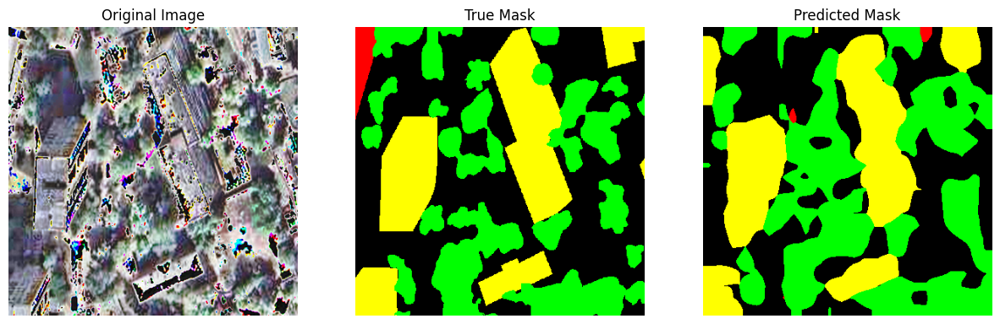

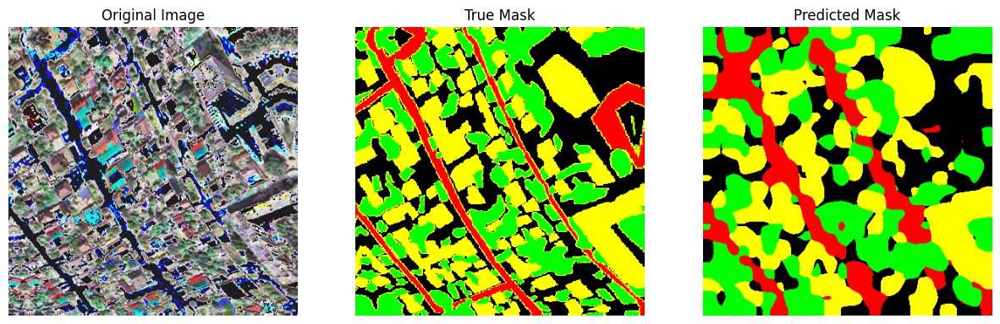

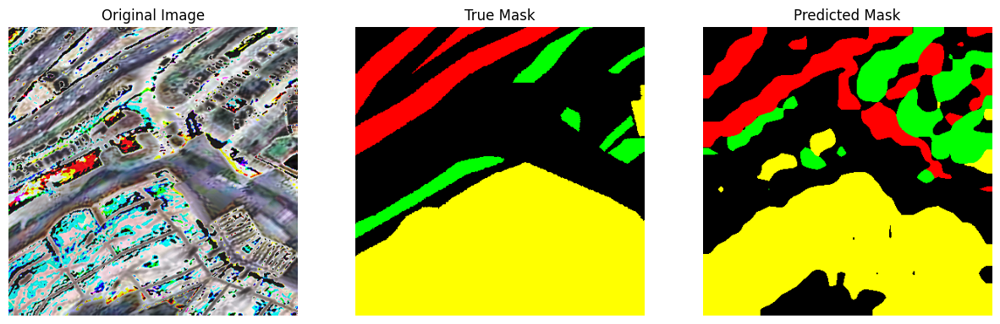

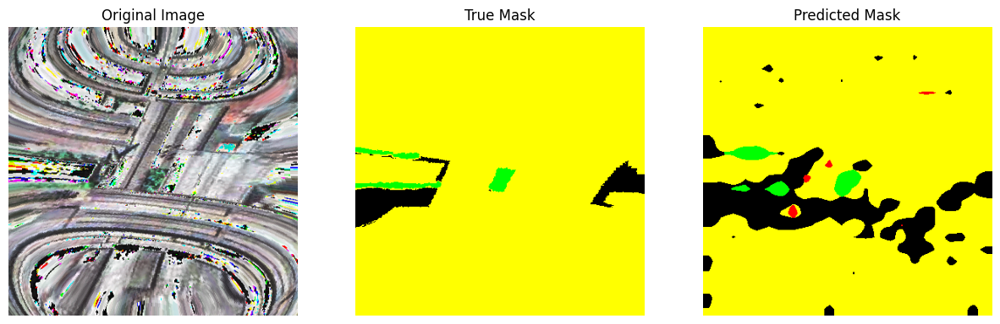

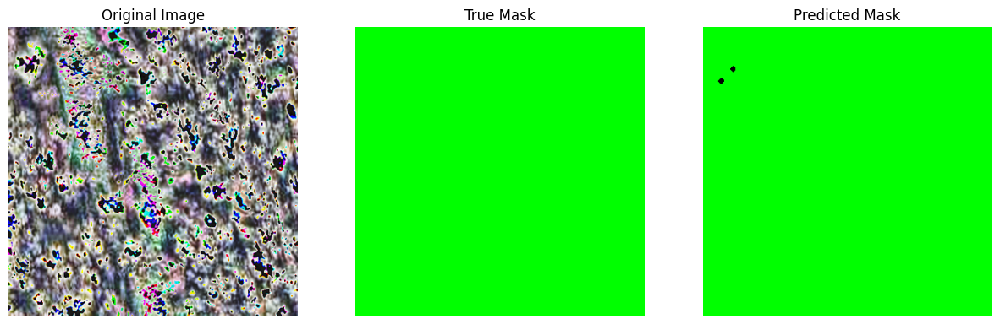

...

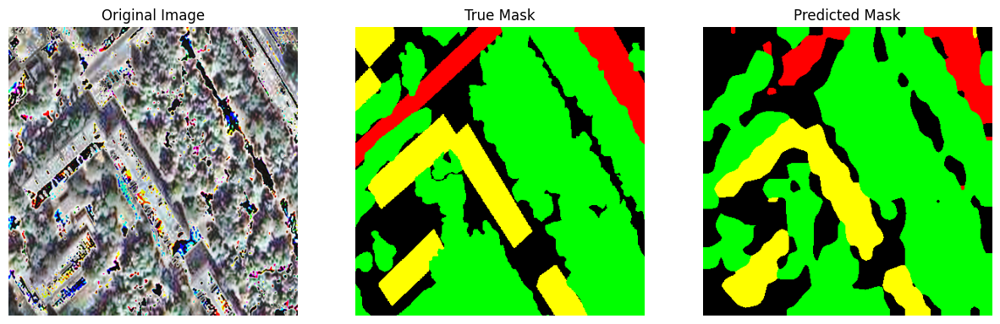

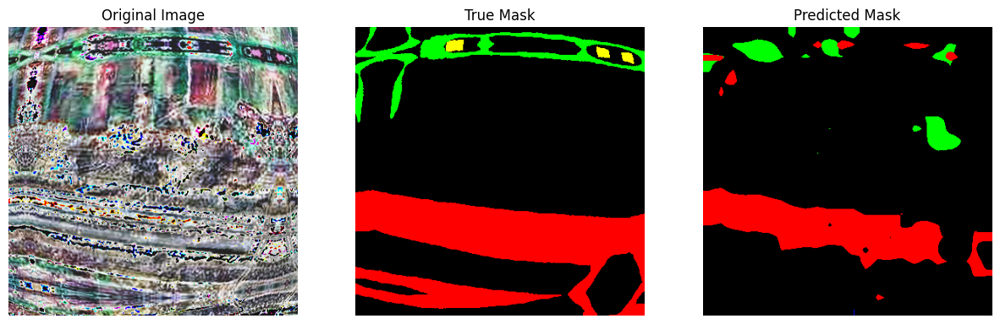

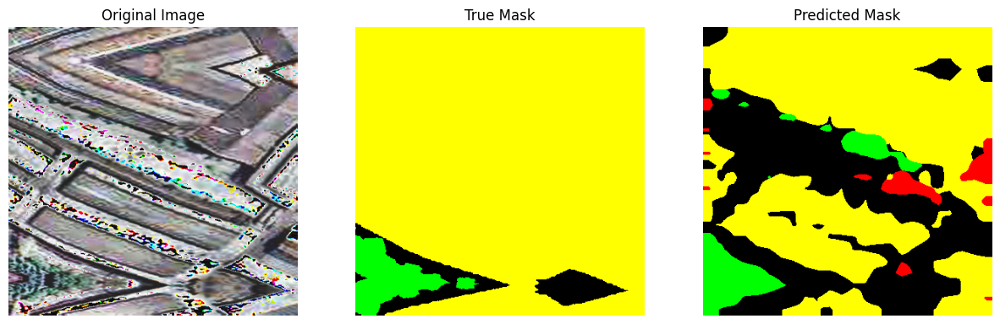

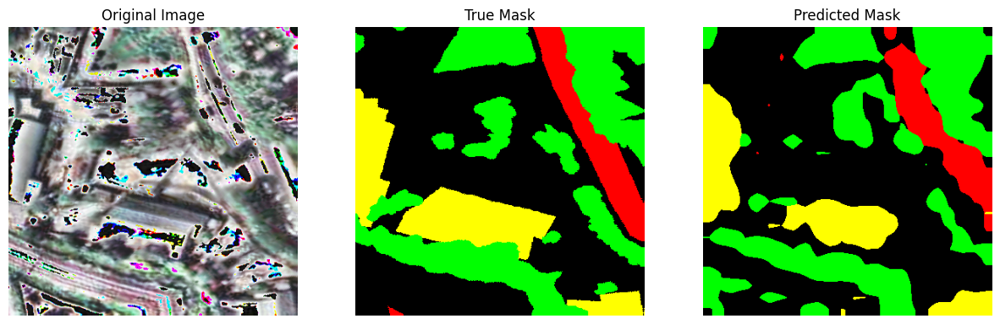

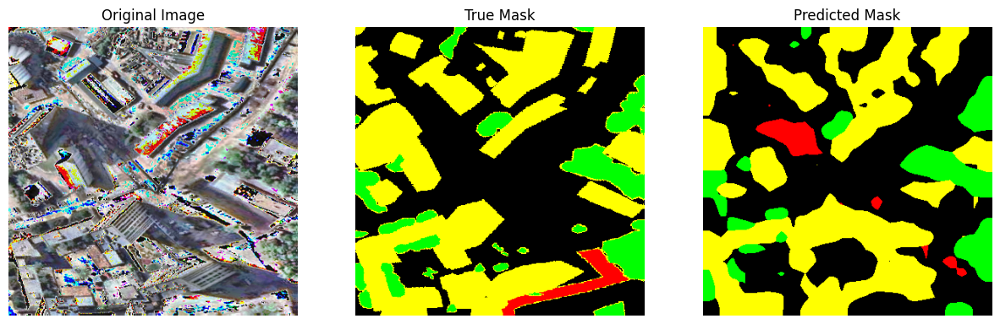

In [25]:
class_dict = {0: (255, 255, 0), 1: (255, 0, 0), 2: (0, 255, 0), 3: (0, 0, 255), 4: (0, 0, 0)}

for images, masks in val_loader:
    images = images.to(device)
    masks = masks.to(device)

    with autocast():
        logits = model(images)
        pred_masks = torch.argmax(logits, dim=1)

    for i in range(2):
        visualize_sample(images[i], masks[i], pred_masks[i], class_dict)

    del images, masks, logits, pred_masks
    torch.cuda.empty_cache()